# Import Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import json
import seaborn as sns
from pandas import json_normalize
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.preprocessing import StandardScaler
from collections import Counter
from wordcloud import WordCloud
import re
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
import requests
from PIL import Image
from io import BytesIO
import os


# Importing Data

In [5]:
with open("D:\instagramproject\json files\Lok_sabha_politicians.json", 'r') as file:
        json_data = json.load(file)

In [3]:
json_data

[{'platformId': '3373041352806012730_3161328178',
  'platform': 'Instagram',
  'date': '2024-05-21 18:58:05',
  'updated': '2024-05-21 21:41:07',
  'type': 'photo',
  'description': 'सम्बलपुर, ओड़िशा में जिला अध्यक्ष श्री गिरीश पटेल जी, माँट उत्तर प्रदेश के विधायक श्री राजेश चौधरी जी एवं भाजपा कार्यकर्ताओं के साथ बैठक किया।',
  'postUrl': 'https://www.instagram.com/p/C7Pcz0-tJc6/',
  'subscriberCount': 59146,
  'score': -1.951219512195122,
  'media': [{'type': 'photo',
    'url': 'https://scontent-sea1-1.cdninstagram.com/v/t39.30808-6/442472992_1023028932518011_5557449025162561908_n.jpg?_nc_cat=110&ccb=1-7&_nc_sid=18de74&_nc_ohc=KWQ9w1L45X0Q7kNvgF-p3e-&_nc_ht=scontent-sea1-1.cdninstagram.com&oh=00_AYBRU_eAoyuSN9jOvulgKP_xbOxQWdZrI6cWqhlXRQePBA&oe=6652ED9C',
    'height': 1080,
    'width': 1440,
    'blip_caption': 'a group of people sitting around a coffee table'}],
  'statistics': {'actual': {'favoriteCount': 40, 'commentCount': 1},
   'expected': {'favoriteCount': 76, 'commentCount':

In [4]:
df = pd.json_normalize(json_data)

# Print the DataFrame
df.head()

,platformId,platform,date,updated,type,description,postUrl,subscriberCount,score,media,...,account.name,account.handle,account.profileImage,account.subscriberCount,account.url,account.platform,account.platformId,account.verified,imageText,expandedLinks
0,3373041352806012730_3161328178,Instagram,2024-05-21 18:58:05,2024-05-21 21:41:07,photo,"सम्बलपुर, ओड़िशा में जिला अध्यक्ष श्री गिरीश पट...",https://www.instagram.com/p/C7Pcz0-tJc6/,59146,-1.951220,"[{'type': 'photo', 'url': 'https://scontent-se...",...,Shandilya Giriraj Singh,girirajsinghbjp,https://scontent-sea1-1.cdninstagram.com/v/t51...,59146,https://www.instagram.com/girirajsinghbjp/,Instagram,3161328178,True,NaN,NaN
1,3373028008914462341_3161328178,Instagram,2024-05-21 18:31:34,2024-05-21 21:41:07,album,आज भगवान जगन्नाथ की पवित्र भूमि झारसुगुड़ा एरप...,https://www.instagram.com/p/C7PZxpgyiaF/,59146,-1.416667,"[{'type': 'photo', 'url': 'https://scontent-se...",...,Shandilya Giriraj Singh,girirajsinghbjp,https://scontent-sea1-1.cdninstagram.com/v/t51...,59146,https://www.instagram.com/girirajsinghbjp/,Instagram,3161328178,True,NaN,NaN
2,3373007412447502105_3412414227,Instagram,2024-05-21 17:50:39,2024-05-21 19:23:53,album,वंदनीय गुरुवर्य धर्मवीर आनंद दिघे साहेब यांच्य...,https://www.instagram.com/p/C7PVF7jsV8Z/,1717654,5.206167,"[{'type': 'photo', 'url': 'https://scontent-se...",...,Eknath Shinde - एकनाथ शिंदे,mieknathshinde,https://scontent-sea1-1.cdninstagram.com/v/t51...,1717654,https://www.instagram.com/mieknathshinde/,Instagram,3412414227,True,NaN,NaN
3,3372980931096992787_11562602006,Instagram,2024-05-21 16:58:02,2024-05-21 19:59:55,photo,Come be a part of an exhilarating door-to-door...,https://www.instagram.com/p/C7PPEk4M9wT/,765837,-3.209841,"[{'type': 'photo', 'url': 'https://scontent-se...",...,Shashi Tharoor,shashitharoor,https://scontent-sea1-1.cdninstagram.com/v/t51...,765837,https://www.instagram.com/shashitharoor/,Instagram,1221263160,True,Date 22 May 2024 DOOR TO DOOR With Dr. Shashi ...,NaN
4,3372976030935094307_1990664062,Instagram,2024-05-21 16:48:18,2024-05-21 19:36:16,album,Ganesh Bhel - Superb BHEL in Baramati! 😋,https://www.instagram.com/p/C7PN9RPyxQj/,1082062,-1.328125,"[{'type': 'photo', 'url': 'https://scontent-se...",...,Supriya Sule,supriyasule,https://scontent-sea1-1.cdninstagram.com/v/t51...,1082062,https://www.instagram.com/supriyasule/,Instagram,1990664062,True,NaN,NaN


In [8]:
df = pd.read_json("../json files/Loksabha_t.json")

In [9]:
df.columns

Index(['platformId', 'platform', 'date', 'updated', 'type', 'description',
       'postUrl', 'subscriberCount', 'score', 'media',
       'likeAndViewCountsDisabled', 'languageCode', 'legacyId', 'id',
       'statistics.actual.favoriteCount', 'statistics.actual.commentCount',
       'statistics.expected.favoriteCount', 'statistics.expected.commentCount',
       'account.id', 'account.name', 'account.handle', 'account.profileImage',
       'account.subscriberCount', 'account.url', 'account.platform',
       'account.platformId', 'account.verified', 'imageText', 'expandedLinks',
       'translated_description', 'translated_imageText'],
      dtype='object')

In [7]:
columns_to_keep = ['date', 'type', 'subscriberCount', 'score', 'id',
       'translated_description', 'statistics.actual.favoriteCount',
       'statistics.actual.commentCount', 'statistics.expected.favoriteCount',
       'statistics.expected.commentCount', 'account.name',
       'account.handle', 'translated_imageText','expandedLinks']

In [ ]:
df = df[columns_to_keep]

In [6]:
df.head()


,platformId,platform,date,updated,type,description,postUrl,subscriberCount,score,media,...,account.name,account.handle,account.profileImage,account.subscriberCount,account.url,account.platform,account.platformId,account.verified,imageText,expandedLinks
0,3373041352806012730_3161328178,Instagram,2024-05-21 18:58:05,2024-05-21 21:41:07,photo,"सम्बलपुर, ओड़िशा में जिला अध्यक्ष श्री गिरीश पट...",https://www.instagram.com/p/C7Pcz0-tJc6/,59146,-1.951220,"[{'type': 'photo', 'url': 'https://scontent-se...",...,Shandilya Giriraj Singh,girirajsinghbjp,https://scontent-sea1-1.cdninstagram.com/v/t51...,59146,https://www.instagram.com/girirajsinghbjp/,Instagram,3161328178,True,NaN,NaN
1,3373028008914462341_3161328178,Instagram,2024-05-21 18:31:34,2024-05-21 21:41:07,album,आज भगवान जगन्नाथ की पवित्र भूमि झारसुगुड़ा एरप...,https://www.instagram.com/p/C7PZxpgyiaF/,59146,-1.416667,"[{'type': 'photo', 'url': 'https://scontent-se...",...,Shandilya Giriraj Singh,girirajsinghbjp,https://scontent-sea1-1.cdninstagram.com/v/t51...,59146,https://www.instagram.com/girirajsinghbjp/,Instagram,3161328178,True,NaN,NaN
2,3373007412447502105_3412414227,Instagram,2024-05-21 17:50:39,2024-05-21 19:23:53,album,वंदनीय गुरुवर्य धर्मवीर आनंद दिघे साहेब यांच्य...,https://www.instagram.com/p/C7PVF7jsV8Z/,1717654,5.206167,"[{'type': 'photo', 'url': 'https://scontent-se...",...,Eknath Shinde - एकनाथ शिंदे,mieknathshinde,https://scontent-sea1-1.cdninstagram.com/v/t51...,1717654,https://www.instagram.com/mieknathshinde/,Instagram,3412414227,True,NaN,NaN
3,3372980931096992787_11562602006,Instagram,2024-05-21 16:58:02,2024-05-21 19:59:55,photo,Come be a part of an exhilarating door-to-door...,https://www.instagram.com/p/C7PPEk4M9wT/,765837,-3.209841,"[{'type': 'photo', 'url': 'https://scontent-se...",...,Shashi Tharoor,shashitharoor,https://scontent-sea1-1.cdninstagram.com/v/t51...,765837,https://www.instagram.com/shashitharoor/,Instagram,1221263160,True,Date 22 May 2024 DOOR TO DOOR With Dr. Shashi ...,NaN
4,3372976030935094307_1990664062,Instagram,2024-05-21 16:48:18,2024-05-21 19:36:16,album,Ganesh Bhel - Superb BHEL in Baramati! 😋,https://www.instagram.com/p/C7PN9RPyxQj/,1082062,-1.328125,"[{'type': 'photo', 'url': 'https://scontent-se...",...,Supriya Sule,supriyasule,https://scontent-sea1-1.cdninstagram.com/v/t51...,1082062,https://www.instagram.com/supriyasule/,Instagram,1990664062,True,NaN,NaN


# Importing  Candidates CSV File

In [10]:
candidates = pd.read_csv('../Lok_sabha_contestents.csv')

In [11]:
candidates.head()

,Id,name,constituency,party,followers,accountHandle,Alignation
0,1,Asaduddin Owaisi,"Hyderabad, Telengana",AIMIM,6.8M,asadowaisiofficial,Right
1,2,Anubhav Mohanty,"Kendrapara, odhisa",BJD,387K,anubhavmohantyofficial,Centre
2,3,Smriti Irani,"Amethi, UP",BJP,1.4M,smritiiraniofficial,Right
3,4,Rajnath Singh,"Lucknow, UP",BJP,1.5M,rajnathsinghbjp,Right
4,5,Amit Shah,"Gandhinagar, GJ",BJP,13.7M,amitshahofficial,Right


In [12]:
candidates.columns

Index(['Id', 'name', 'constituency', 'party', 'followers', 'accountHandle',
       'Alignation'],
      dtype='object')

# Exploratory Data Analysis

### Count of Party by Alignment

In [13]:
alignation_grouped = candidates.groupby('Alignation')['party'].value_counts()


In [14]:
candidates['Alignation'].value_counts()

Alignation
Right     25
Centre    18
Left       7
Name: count, dtype: int64

In [15]:
def plot_party_with_alignation(alignation_grouped, title, columns):
    df = alignation_grouped.reset_index()
    df.columns = columns
    color_map = {
        "Centre": "blue",
        "Left": "red",
        "Right": "green"
    }
    fig = px.bar(
        df,
        x=columns[1],
        y=columns[2],
        color=columns[0],
        color_discrete_map=color_map,
        title=f"Count of {title} by Alignment",
        
    )
    fig.show()


In [16]:
plot_party_with_alignation(alignation_grouped, 'party', ['Alignation', 'party', 'count'])


In [17]:
df = pd.merge(df, candidates[['accountHandle', 'party', 'Alignation']], left_on='account.handle', right_on = "accountHandle", how='left')

In [18]:
df = df.drop_duplicates(subset='id', keep='first')

In [19]:
df['party'].nunique()

16

In [39]:
tdf = df[df['Alignation']=='Right']
tdf.to_csv("../data dir/translated_description_right.csv")

### Count of posts by Party Alignment

In [20]:
df_aligned = df.groupby('Alignation')['party'].value_counts()
df_aligned

Alignation  party
Centre      INC      1622
            NCP       683
            SAD       580
            NPP       277
            TMC       105
            AITC       94
            BJD        66
            JD(U)      51
Left        LJSP     1135
            BSP       306
            DMK       139
            JD(S)     139
            SP         53
Right       SS       4879
            BJP      4611
            AIMIM     613
Name: count, dtype: int64

In [21]:
plot_party_with_alignation(df_aligned, "posts", ['Alignation', 'party', 'count'])

### Count of posts by Account Handles

In [22]:
df_ind_aligned = df.groupby('Alignation')['account.handle'].value_counts()
plot_party_with_alignation(df_ind_aligned, 'Account Handles', ['Alignation', 'account.handle', 'count'])

In [23]:
df[['statistics.actual.commentCount', 'account.name']]

,statistics.actual.commentCount,account.name
0,29,Anubhav Mohanty
1,74,Anubhav Mohanty
2,15,Veena Devi
3,95,Eknath Shinde - एकनाथ शिंदे
4,4411,Rahul Gandhi
...,...,...
15348,0,Shandilya Giriraj Singh
15349,18,Shandilya Giriraj Singh
15350,18,Kiren Rijiju
15351,19,Nitin Gadkari


In [24]:
def distribution_of_posts_byAlignation(df, columns, target, type):
    if(type=='avg'):
        tdf = df.groupby(columns)[target].mean()
    elif(type=='sum'):
        tdf = df.groupby(columns)[target].sum()
    else:
        print('Not a correct type')
        return
    tdf = tdf.reset_index()
    fig = px.bar(
        tdf,
        x=columns[0],  # Alignation on x-axis
        y= target,  # Sum of favorites on y-axis
        color=columns[1],  # Stacked by account handle
        title=f'{type} of {target} by {columns[0]} and {columns[1]}',
        barmode='stack'  # Stack the bars for each account handle
    ) 
    fig.show()

### Count of Total Likes by Alignments and Account Handle

In [25]:
distribution_of_posts_byAlignation(df, ['Alignation', 'account.handle'], 'statistics.actual.favoriteCount', 'sum')

### Count of Avg Likes by Alignments and Account Handle

In [26]:
distribution_of_posts_byAlignation(df, ['Alignation', 'account.handle'], 'statistics.actual.favoriteCount', 'avg')

### Count of Avg Comments by Alignments and Account Handle

In [27]:
distribution_of_posts_byAlignation(df, ['Alignation', 'account.handle'], 'statistics.actual.commentCount', 'avg')

### Time series Area Plot with Alignation

In [28]:
time_df = df[['date', 'Alignation']]
time_df['date'] = pd.to_datetime(time_df['date'])
grouped_df = time_df.groupby(['Alignation', time_df['date'].dt.date]).size().reset_index(name='Count')

fig = px.area(
    grouped_df,
    x='date',
    y='Count',
    color='Alignation',
    title='Time Series Plot by Alignation',
    labels={'date': 'Date', 'Count': 'Count'}
)
fig.show()

C:\Users\hp\AppData\Local\Temp\ipykernel_22300\3497699309.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



April 14, 2024: ['Congress announces 10 more candidates for Lok Sabha polls', 'PM Modi holds massive roadshow in Mangaluru', 'Congress insults women, didn’t give due respect to Ambedkar, Savarkar, claims BJP candidate Kangana', 'Will take steps to make west UP separate state if voted to power at Centre: Mayawati']

April 17, 2024: ['Modi government will eliminate Naxals in very short period of time: Amit Shah', 'Congress leader Rahul Gandhi and Samajwadi Party (SP) chief Akhilesh Yadav — will hold a joint press conference in Ghaziabad today to support Congress' candidate Dolly Sharma.']

April 21, 2024: ['Despite heatwave, Phase I of Lok Sabha polls registers 63.89% polling', 'BJP files complaint against Congress for ‘assassinating’ Kangana Ranaut’s character', 'Adhir Chowdhury hopeful Cong-Left seat-sharing alliance will bear fruit']

April 23: 2024: ['‘Arvind Kejriwal finally given insulin’: AAP']

May 1, 2024: ['Prime Minister Inaugurates 91 FM Radio Transmitters, To Benefit Border, Aspirational Districts', ' Agriculture Minister Narendra Singh Tomar launches ‘Millets Experience Centre’ at Dilli Haat']



In [28]:
def correlation_scatterplot(df, columns):
    tdf = df[columns]
    fig = px.scatter(
        tdf,
        x=columns[1],
        y=columns[0],
        title=f'Scatter Plot of {columns[1]} vs. {columns[0]}',
        labels={columns[1], columns[0]},
        trendline='ols',  # Fit a regression line (OLS) to the data
        color = columns[2]
    )

    fig.show()

In [29]:
correlation_scatterplot(df, ['score', 'statistics.actual.commentCount', 'Alignation'])

In [30]:
correlation_scatterplot(df, ['score', 'statistics.actual.favoriteCount', 'Alignation'])

In [31]:
correlation_scatterplot(df, ['statistics.expected.favoriteCount', 'statistics.actual.favoriteCount', 'Alignation'])

In [32]:
correlation_scatterplot(df, ['statistics.expected.commentCount', 'statistics.actual.commentCount', 'Alignation'])

Topic modelling

In [33]:
desc_df = df['translated_description']
desc_df = translated_df['translated_description']

In [34]:
desc_df

0        सम्बलपुर, ओड़िशा में जिला अध्यक्ष श्री गिरीश पट...
1        आज भगवान जगन्नाथ की पवित्र भूमि झारसुगुड़ा एरप...
2        वंदनीय गुरुवर्य धर्मवीर आनंद दिघे साहेब यांच्य...
3        Come be a part of an exhilarating door-to-door...
4                 Ganesh Bhel - Superb BHEL in Baramati! 😋
                               ...                        
14976    माननीय प्रधानमंत्रीजी श्री @narendramodi jÍ द्...
14977                                           जय महादेव।
14978    Tawang Marathon is one of the most exciting ma...
14979    प्रतिभावंत साहित्यिक, गीतकार ग. दि. माडगूळकर य...
14980    महान स्वतंत्रता सेनानी एच. एन. कुन्जरू जी की ज...
Name: description, Length: 14981, dtype: object

In [35]:
desc_df.iloc[1]

'आज भगवान जगन्नाथ की पवित्र भूमि झारसुगुड़ा एरपोर्ट, ओड़िशा  मेरे आगमन पर भाजपा कार्यकर्ताओं द्वारा भव्य स्वागत एवं अभिनंदन किया गया। आप सभी द्वारा मिले इस अपार स्नेह व अपनत्व के लिए हृदय से आभार व्यक्त करता हूँ।'

In [84]:
import re
def extract_hashtags(text):
    if isinstance(text, str):  
        hashtags = re.findall(r'#([a-zA-Z0-9_]+(?: [a-zA-Z0-9_]+)*)', text)
        # Rejoin matched groups with the '#' symbol to form complete hashtags
        hashtags = [f'#{hashtag}' for hashtag in hashtags]
        return hashtags
    else:
        return [] 

def extract_mentions(text):
    if isinstance(text, str):  # Check if the input is a string
        # Regex pattern to match mentions
        mentions = re.findall(r'@[a-zA-Z0-9_]+', text)
        return mentions
    else:
        return []



In [86]:
df['mentions'] = df['translated_description'].apply(extract_mentions)
df['hashtags'] = df['translated_description'].apply(extract_hashtags)

In [87]:
df['mentions']

0                       []
1                       []
2                       []
3                       []
4                       []
               ...        
14976      [@narendramodi]
14977                   []
14978    [@pemakhandu_bjp]
14979                   []
14980                   []
Name: mentions, Length: 14981, dtype: object

In [89]:
mention_df = df[['account.handle', 'mentions']]

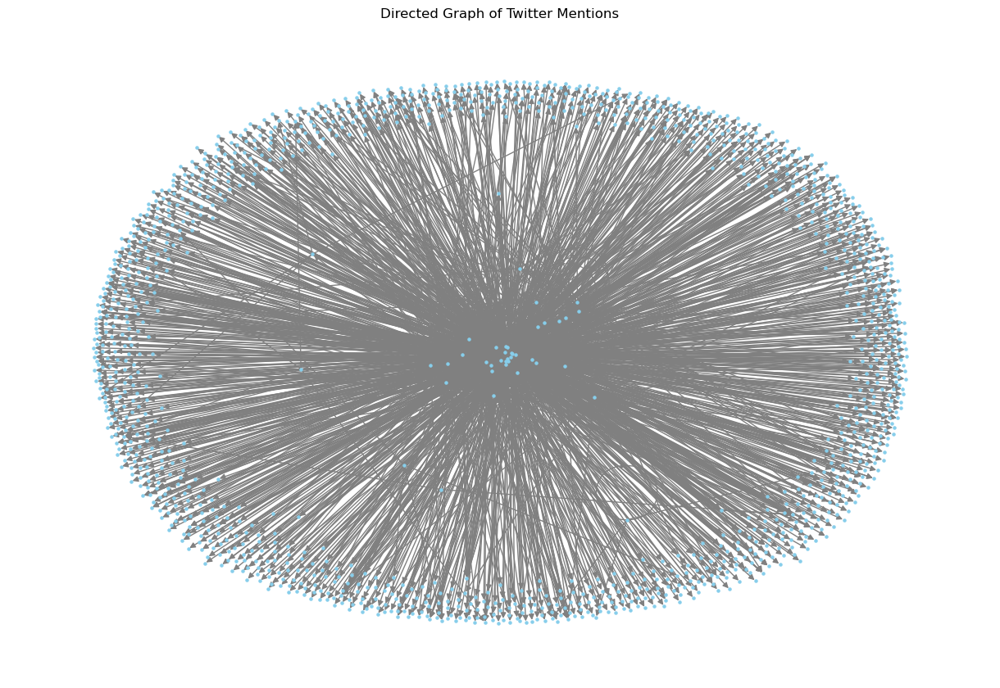

In [95]:
# Create a directed graph
G = nx.DiGraph()

# Add edges to the graph, ensuring no duplicates
for index, row in mention_df.iterrows():
    source = row['account.handle']
    mentions = [mention.lstrip('@') for mention in row['mentions']]
    for target in mentions:
        if not G.has_edge(source, target):
            G.add_edge(source, target)

# Plot the graph
plt.figure(figsize=(12, 8))
pos = nx.spring_layout(G, k=0.1)  # positions for all nodes

# Draw the graph
nx.draw(G, pos, with_labels=False, node_size=5, node_color="skyblue", font_size=10, font_weight="bold", edge_color="gray")
plt.title("Directed Graph of Twitter Mentions")
plt.show()


In [96]:
num_edges = G.number_of_edges()
num_nodes = G.number_of_nodes()

print(f"Number of edges: {num_edges}")
print(f"Number of nodes: {num_nodes}")

Number of edges: 1685
Number of nodes: 1323


In [106]:
num_strongly_connected_components = nx.number_strongly_connected_components(G)
num_weakly_connected_components = nx.number_weakly_connected_components(G)

print(f"Number of strongly connected components: {num_strongly_connected_components}")
print(f"Number of weakly connected components: {num_weakly_connected_components}")

Number of strongly connected components: 1315
Number of weakly connected components: 2


In [102]:
def plot_centrality(centrality, g, sp):
    # Calculate number of nodes to consider (top 10%)
    num_nodes = int(0.1 * len(g.nodes()))

    all_nodes = [(node, centrality[node]) for node in centrality]
    sorted_nodes = sorted(all_nodes, key=lambda x: x[1])
    top_nodes = [n for (n, c) in sorted_nodes[-num_nodes:]]
    node_colors = ['red' if node in top_nodes else 'yellow' for node in g.nodes()]
    plt.figure(figsize=(14, 6))
    plt.subplot(1, 2, 1)
    nx.draw(g, pos=sp, node_color=node_colors, with_labels=False, alpha=0.2)
    plt.title("Centrality measure for top nodes as red")

    top_10 = sorted_nodes[-10:]
    df = pd.DataFrame(top_10, columns=['Node', 'Centrality'])

    plt.subplot(1, 2, 2)
    plt.table(cellText=df.values, colLabels=df.columns, cellLoc='center', loc='center')
    plt.axis('off')
    plt.title("Top 10 Nodes of Top Ranked")

    plt.tight_layout()
    plt.show()

In [112]:
def centrality(g, centrality, sp):
  match centrality:
    case "indegree":
      indegree_centrality = nx.in_degree_centrality(g)
      plot_centrality(indegree_centrality, g, sp)
      return indegree_centrality
    case "outdegree":
      outdegree_centrality = nx.out_degree_centrality(g)
      plot_centrality(outdegree_centrality, g, sp)
      return outdegree_centrality
    case "degree":
      degree_centrality = nx.degree_centrality(g)
      plot_centrality(degree_centrality, g, sp)
      return degree_centrality
    case 'eigenvector':
      eigenvector_centrality = nx.eigenvector_centrality(g)
      plot_centrality(eigenvector_centrality, g, sp)
      return eigenvector_centrality
    case 'pagerank':
      pagerank_centrality = nx.pagerank(g)
      plot_centrality(pagerank_centrality, g, sp)
      return pagerank_centrality
    case 'closeness':
      closeness_centrality = nx.closeness_centrality(g)
      plot_centrality(closeness_centrality, g, sp)
      return closeness_centrality
    case 'betweenness':
      betweenness_centrality = nx.betweenness_centrality(g)
      plot_centrality(betweenness_centrality, g, sp)
      return betweenness_centrality
    case 'katz':
      katz_centrality = nx.katz_centrality(g, alpha = 0.1, beta = 1, max_iter=2000, tol = 1e-6)
      plot_centrality(katz_centrality, g, sp)
      return katz_centrality
    case _:
      print("Not a valid centrality")

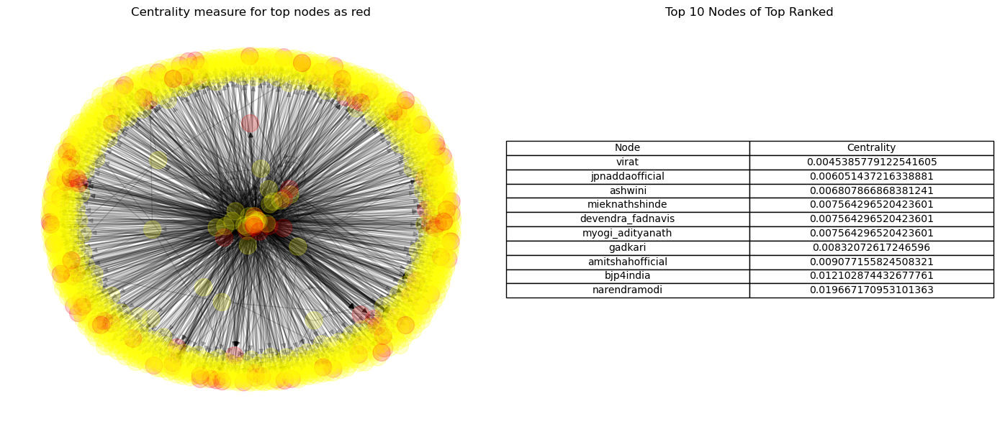

In [113]:
indegree = centrality(G, 'indegree', pos)

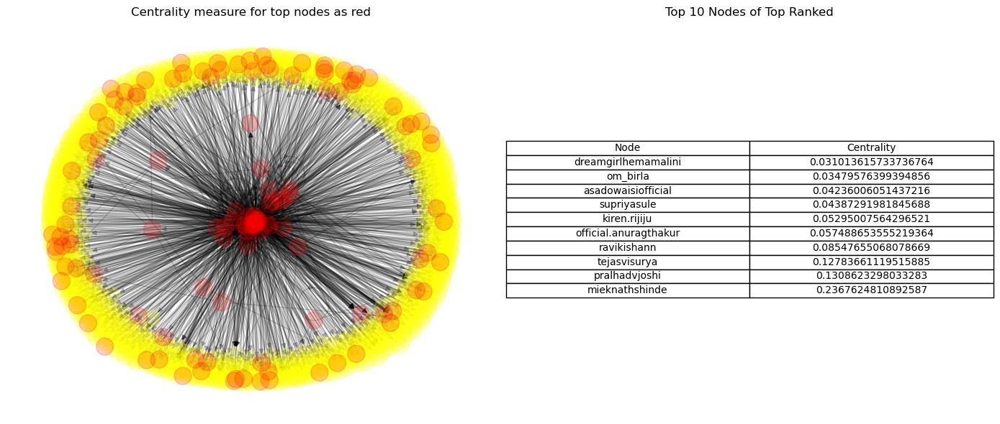

In [114]:
outdegree = centrality(G, 'outdegree', pos)

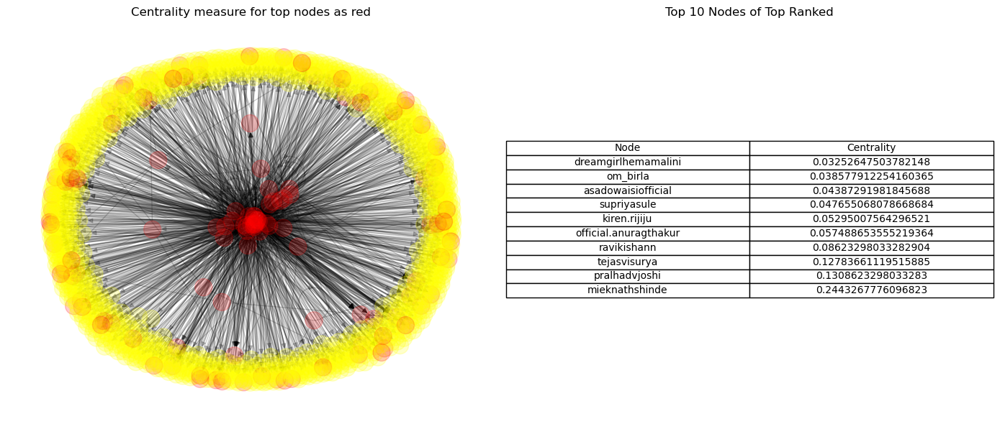

In [115]:
degree = centrality(G, 'degree', pos)

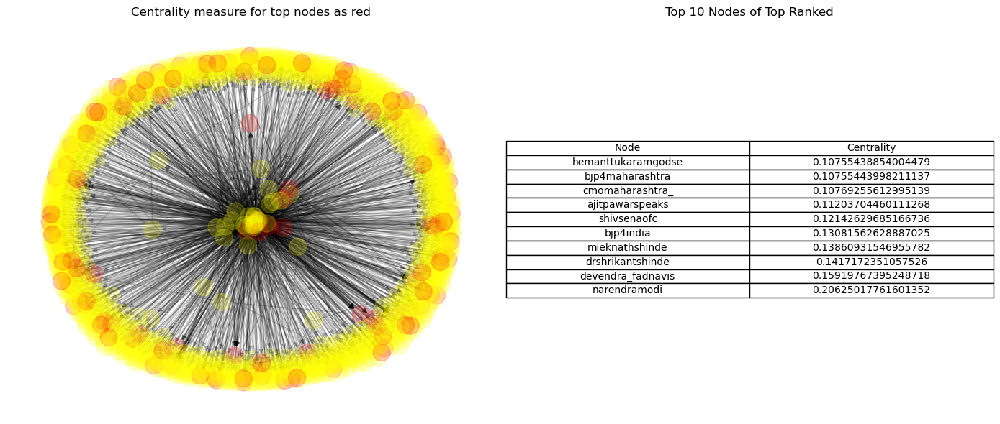

In [116]:
eigenvector = centrality(G, 'eigenvector', pos)

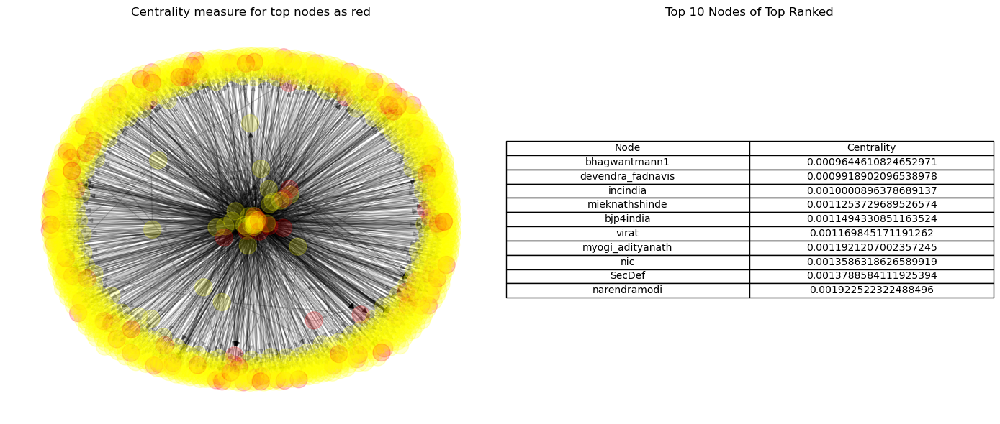

In [117]:
pagerank = centrality(G, 'pagerank', pos)

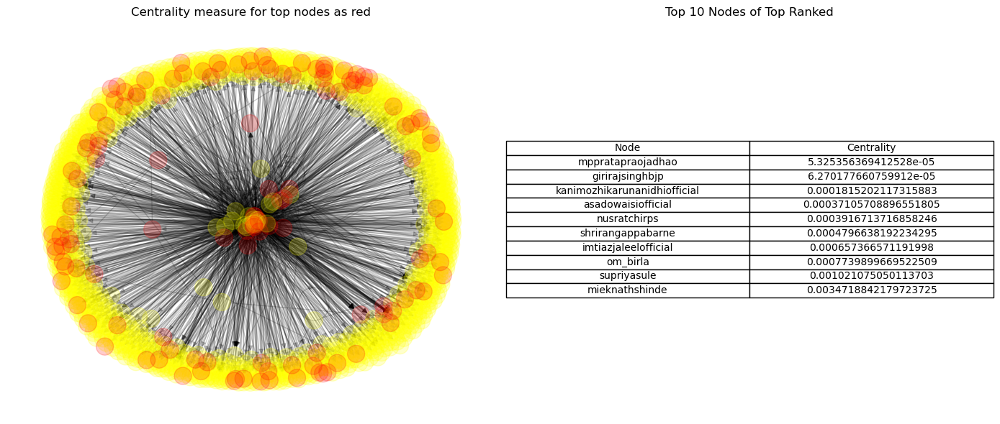

In [118]:
betweenness = centrality(G, 'betweenness', pos)

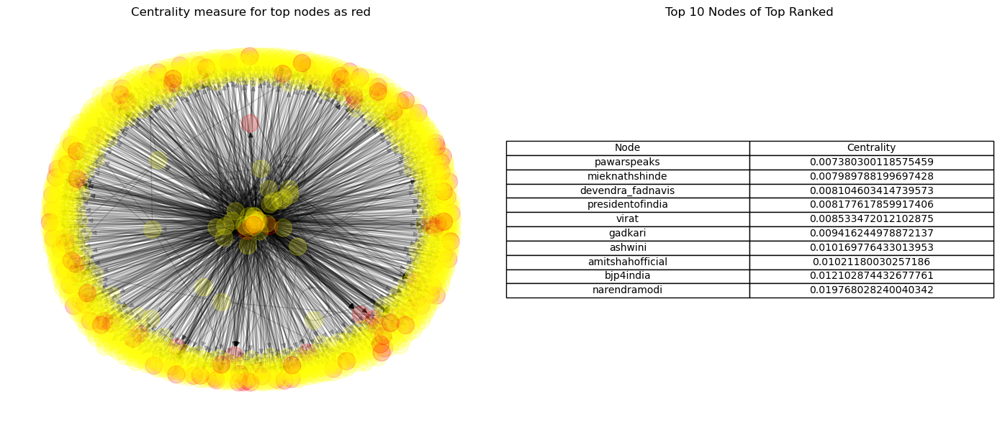

In [119]:
closeness = centrality(G, 'closeness', pos)

In [120]:
df['hashtags']

0                                     []
1                                     []
2                                     []
3                                     []
4                                     []
                      ...               
14976                                 []
14977                                 []
14978    [#TawangMarathon very exciting]
14979                                 []
14980                                 []
Name: hashtags, Length: 14981, dtype: object

In [44]:
def unique_values(df, column):
    exploded_series = df[column].explode()
    uq_values = exploded_series.unique()
    return uq_values

def fractions(df, column):
    fraction = df[column].apply(lambda x: len(x)>0)
    avg = fraction.mean()
    return avg

In [45]:
unique_hashtags = unique_values(df, 'hashtags')
unique_mentions = unique_values(df, 'mentions')
len(unique_hashtags), len(unique_mentions)

(8372, 1602)

In [46]:
fraction_with_tags = fractions(df, 'hashtags')
fractions_with_mentions = fractions(df, 'mentions')
fraction_with_tags*100, fractions_with_mentions*100

(58.37481933515336, 18.84535089127991)

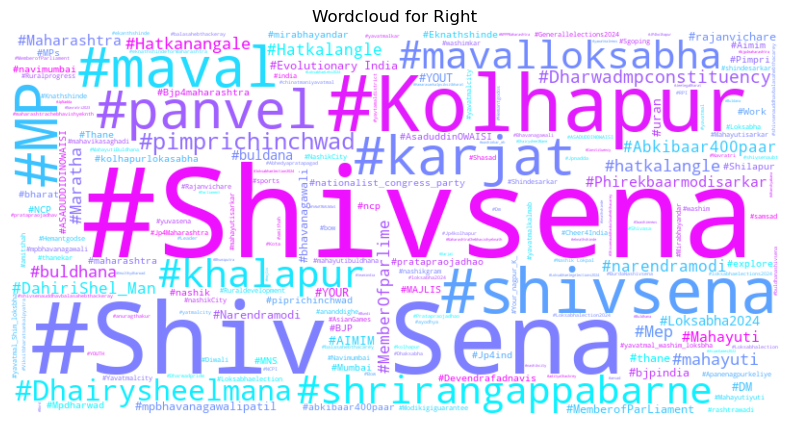

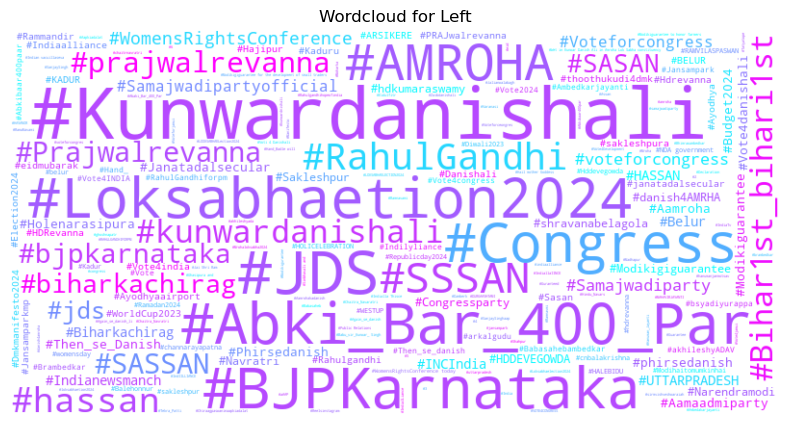

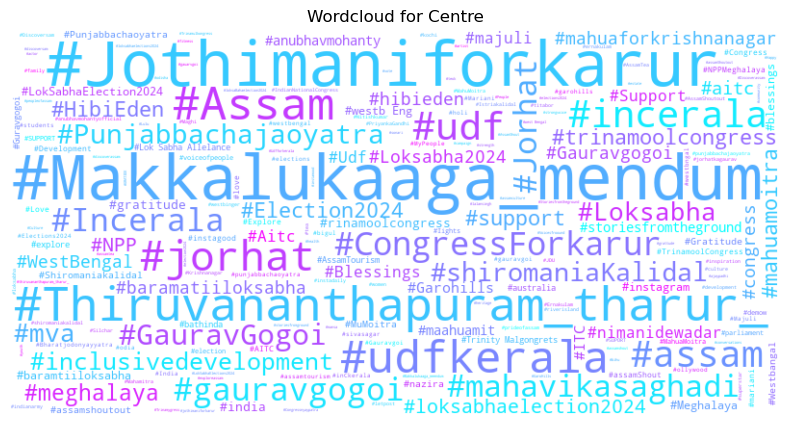

In [47]:

def count_hashtags_by_alignation(df):
    alignation_counts = {}

    for alignation in df['Alignation'].unique():
        filtered_df = df[df['Alignation'] == alignation]
        
        all_hashtags = [hashtag for hashtags in filtered_df['hashtags'] for hashtag in hashtags]
        hashtag_counts = Counter(all_hashtags)
        alignation_counts[alignation] = hashtag_counts
        
    return alignation_counts

alignation_counts = count_hashtags_by_alignation(df[['hashtags', 'Alignation']])

for alignation, counts in alignation_counts.items():
    
    wordcloud = WordCloud(
        width=800,
        height=400,
        background_color='white',
        colormap='cool'
    ).generate_from_frequencies(counts)
    
    plt.figure(figsize=(10, 5))
    plt.title(f"Wordcloud for {alignation}")
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.show()

# Topic Modelling

In [122]:
def preprocess_text(text):
   
    if not isinstance(text, str):
        return ""
    
    emoji_pattern = re.compile("["
                               u"\U0001F600-\U0001F64F"  # Emoticons
                               u"\U0001F300-\U0001F5FF"  # Symbols & pictographs
                               u"\U0001F680-\U0001F6FF"  # Transport & map symbols
                               u"\U0001F700-\U0001F77F"  # Alchemical symbols
                               u"\U0001F780-\U0001F7FF"  # Geometric Shapes
                               u"\U0001F800-\U0001F8FF"  # Supplemental Arrows-C
                               u"\U0001F900-\U0001F9FF"  # Supplemental Symbols and Pictographs
                               u"\U0001FA00-\U0001FA6F"  # Chess Symbols
                               u"\U0001FA70-\U0001FAFF"  # Symbols and Pictographs Extended-A
                               u"\U00002702-\U000027B0"  # Dingbats
                               "]+", flags=re.UNICODE)
    text = emoji_pattern.sub(r'', text)
    text = text.lower()
    text = re.sub(r'[^\w\s]', '', text)
    
    return text


In [74]:
df['translated_description'] = df['translated_description'].apply(preprocess_text)

In [174]:
def topic_analysis_onAlignation(df, alignation, bycolumn):
    topic = df[df['Alignation']==alignation][bycolumn]
    vectorizer = CountVectorizer(stop_words='english', max_features=1000)
    text_vectorized = vectorizer.fit_transform(topic)
    
    num_components_range = range(2, 10)  # Iteratively use 2 to 5 components

    for num_components in num_components_range:
        # Perform LDA (Latent Dirichlet Allocation) for topic modeling
        lda = LatentDirichletAllocation(n_components=num_components, random_state=42)
        lda.fit(text_vectorized)

        # Get the feature names (words) from the vectorizer
        feature_names = vectorizer.get_feature_names_out()

        # Display the top words for each topic
        n_top_words = 10  

        print(f"\nNumber of components: {num_components}")
        for topic_idx, topic in enumerate(lda.components_):
            print(f"Topic {topic_idx + 1}:")
            top_words = [feature_names[i] for i in topic.argsort()[:-n_top_words - 1:-1]]
            print(", ".join(top_words))
            print()

### Topic modelling of translated description

In [84]:
topic_analysis_onAlignation(df, 'Centre','translated_description')


Number of components: 2
Topic 1:
panchayat, mr, president, government, constituency, congress, people, assam, union, state

Topic 2:
singh, ji, india, happy, today, people, day, great, congress, family


Number of components: 3
Topic 1:
panchayat, assam, president, union, development, jorhat, sangma, mr, national, congress

Topic 2:
karur, congress, district, india, constituency, people, mr, assembly, union, happy

Topic 3:
singh, ji, today, people, day, punjab, akali, family, dal, sahib


Number of components: 4
Topic 1:
assam, shri, jorhat, sangma, support, aro, president, sabha, people, baksa

Topic 2:
ji, happy, singh, day, guru, family, sahib, great, baba, today

Topic 3:
akali, punjab, dal, today, shiromani, singh, party, people, government, minister

Topic 4:
panchayat, india, union, congress, karur, mr, district, constituency, assembly, committee


Number of components: 5
Topic 1:
president, sangma, shri, aro, mla, baksa, national, sabha, lok, garo

Topic 2:
india, people, con

In [85]:
topic_analysis_onAlignation(df, 'Left','translated_description')


Number of components: 2
Topic 1:
lok, sabha, amroha, constituency, india, assembly, vaishali, danish, alliance, ali

Topic 2:
shri, minister, ji, today, jds, leaders, hassan, mla, president, bihar


Number of components: 3
Topic 1:
lok, sabha, amroha, constituency, assembly, vaishali, india, danish, alliance, ali

Topic 2:
ji, minister, bihar, country, happy, day, today, shri, countrymen, happiness

Topic 3:
today, shri, jds, leaders, hassan, mla, minister, meeting, district, mr


Number of components: 4
Topic 1:
lok, sabha, amroha, constituency, assembly, india, vaishali, danish, ali, alliance

Topic 2:
ji, bihar, minister, countrymen, happiness, shri, happy, wishes, life, prime

Topic 3:
today, india, country, people, tamil, anniversary, family, social, met, indian

Topic 4:
shri, jds, leaders, hassan, mla, minister, president, district, bjpkarnataka, meeting


Number of components: 5
Topic 1:
sabha, lok, amroha, constituency, assembly, vaishali, india, danish, ali, congress

Topic 

In [86]:
topic_analysis_onAlignation(df, 'Right','translated_description')


Number of components: 2
Topic 1:
shiv, sena, shivsena, chief, mp, mahayuti, sabha, present, kolhapur, lok

Topic 2:
minister, shri, india, ji, government, prime, today, state, modi, people


Number of components: 3
Topic 1:
shiv, sena, shivsena, mp, mahayuti, chief, kolhapur, sabha, lok, present

Topic 2:
minister, state, maharashtra, chief, government, mumbai, present, occasion, mla, district

Topic 3:
shri, ji, india, minister, prime, modi, today, narendramodi, bjp, sri


Number of components: 4
Topic 1:
shivsena, kolhapur, mp, sena, shiv, maval, mahayuti, sabha, hatkalangle, lok

Topic 2:
minister, state, mumbai, maharashtra, chief, government, anniversary, aimim, development, present

Topic 3:
shri, india, minister, ji, prime, modi, today, narendramodi, bjp, sri

Topic 4:
shiv, sena, chief, shivsena, district, present, mla, occasion, minister, thane


Number of components: 5
Topic 1:
shivsena, mahayuti, maval, panvel, karjat, sabha, khalapur, mavalloksabha, shrirangappabarne, lok


In [157]:
df.columns

Index(['platformId', 'platform', 'date', 'updated', 'type', 'description',
       'postUrl', 'subscriberCount', 'score', 'media',
       'likeAndViewCountsDisabled', 'languageCode', 'legacyId', 'id',
       'statistics.actual.favoriteCount', 'statistics.actual.commentCount',
       'statistics.expected.favoriteCount', 'statistics.expected.commentCount',
       'account.id', 'account.name', 'account.handle', 'account.profileImage',
       'account.subscriberCount', 'account.url', 'account.platform',
       'account.platformId', 'account.verified', 'imageText', 'expandedLinks',
       'accountHandle', 'party', 'Alignation'],
      dtype='object')

### Topic Modeling of Image to Text caption 

In [172]:
new_data = {'Alignation': [], 'blip_caption': []}

# Iterate over rows and extract values
for index, row in df[['Alignation', 'media']].iterrows():
    alignation = row['Alignation']
    if isinstance(row['media'], list):
        for media_dict in row['media']:
            blip_caption = media_dict['blip_caption']
            new_data['Alignation'].append(alignation)
            new_data['blip_caption'].append(blip_caption)

new_df = pd.DataFrame(new_data)

new_df

,Alignation,blip_caption
0,Right,a group of people sitting around a coffee table
1,Right,a group of men standing around a man in a pink...
2,Right,three men in white shirts stand around a patie...
3,Centre,a poster for the event
4,Centre,a food vendor selling food at a street in mumbai
...,...,...
15327,Right,
15328,Right,
15329,Right,
15330,Right,the poster for the event of the maha maha maha...


In [176]:
topic_analysis_onAlignation(new_df, 'Centre','blip_caption')


Number of components: 2
Topic 1:
sonia, people, poster, party, event, standing, group, guru, congress, crowd

Topic 2:
man, singh, woman, sari, white, shirt, book, holding, india, self




Number of components: 3
Topic 1:
sonia, people, event, poster, group, standing, party, congress, crowd, swami

Topic 2:
singh, woman, sari, man, white, shirt, book, india, self, blue

Topic 3:
man, guru, bjp, poster, party, mani, standing, recruitment, movie, holding


Number of components: 4
Topic 1:
sonia, event, poster, men, people, maha, ram, walking, crowd, holding

Topic 2:
singh, party, congress, india, bjp, person, book, woman, leader, dress

Topic 3:
guru, man, mani, recruitment, movie, poster, beard, holding, street, picture

Topic 4:
woman, man, sari, standing, people, white, shirt, group, sitting, swami


Number of components: 5
Topic 1:
poster, party, event, congress, bjp, leader, maha, men, movie, delhi

Topic 2:
singh, india, person, book, woman, launch, man, technology, rally, vs

Topic 3:
guru, man, mani, recruitment, beard, photo, men, food, holding, baby

Topic 4:
woman, man, sari, white, shirt, standing, swami, self, blue, red

Topic 5:
sonia, people, group, sittin

In [178]:
topic_analysis_onAlignation(new_df, 'Left','blip_caption')


Number of components: 2
Topic 1:
people, woman, group, standing, crowd, man, sitting, table, gathered, flowers

Topic 2:
sari, singh, poster, event, sar, party, bjp, ram, person, woman


Number of components: 3
Topic 1:
people, group, standing, crowd, woman, sitting, gathered, marathi, gan, building

Topic 2:
sari, singh, poster, event, sar, table, person, woman, women, upcoming

Topic 3:
man, party, bjp, woman, ram, shirt, white, leader, red, congress


Number of components: 4
Topic 1:
people, group, standing, crowd, sitting, table, gathered, marathi, gan, building

Topic 2:
sari, singh, poster, event, sar, person, woman, upcoming, women, maha

Topic 3:
party, bjp, man, ram, shirt, leader, white, outside, gujarat, poster

Topic 4:
woman, man, flowers, putting, guru, head, sari, yellow, face, flower


Number of components: 5
Topic 1:
people, group, standing, crowd, sitting, table, gathered, marathi, gan, building

Topic 2:
sari, singh, poster, event, sar, person, woman, upcoming, wome

In [177]:
topic_analysis_onAlignation(new_df, 'Right','blip_caption')


Number of components: 2
Topic 1:
singh, swami, maha, bjp, party, guru, leader, ram, person, gandhi

Topic 2:
man, poster, event, people, standing, shirt, white, group, india, woman


Number of components: 3
Topic 1:
swami, guru, ram, person, gandhi, gan, gujarat, reddy, sari, modi

Topic 2:
man, people, standing, shirt, white, group, sitting, poster, woman, men

Topic 3:
singh, maha, bjp, party, poster, event, leader, shrian, candidate, rally


Number of components: 4
Topic 1:
swami, person, gandhi, gan, reddy, modi, pm, ba, screenshot, podium

Topic 2:
man, people, standing, shirt, white, group, sitting, men, woman, crowd

Topic 3:
singh, maha, bjp, party, leader, poster, shrian, candidate, rally, durga

Topic 4:
poster, guru, event, ram, india, sari, hindi, image, book, bang


Number of components: 5
Topic 1:
swami, person, gandhi, gan, reddy, modi, pm, ba, flowers, podium

Topic 2:
man, people, standing, group, sitting, gujarat, men, crowd, table, suit

Topic 3:
singh, maha, bjp, p

# Sentiment Analysis

In [176]:
tdf = df[df['Alignation']=='Left'][['translated_description', 'party', 'hashtags', 'account.handle']]
tdf = tdf[tdf['hashtags'].apply(lambda x: len(x)>0)]
tdf = tdf[tdf['account.handle']=='iveenadevi']
# tdf.loc[313]['translated_description']
tdf

,translated_description,party,hashtags,account.handle
19,public relations in bhagwanpur kashi basatpur ...,LJSP,"[#Abki_Bar_400_Par, #Loksabhaetion2024, #Naren...",iveenadevi
46,public relations in himmatpatti and dharopali ...,LJSP,"[#Abki_Bar_400_Par, #Loksabhaetion2024]",iveenadevi
52,public relations in baidhanathpur and vasudevp...,LJSP,"[#Abki_Bar_400_Par, #Loksabhaetion2024]",iveenadevi
94,public relations in bhathandi and ahiyapur of ...,LJSP,"[#Abki_Bar_400_Par, #Loksabhaetion2024]",iveenadevi
119,power to fishermen\n\naddressing significant i...,LJSP,"[#Modikigurantee, #Abki_Bar_400_Par, #Loksabha...",iveenadevi
123,public relations in bhagwatpur and madarana of...,LJSP,"[#Abki_Bar_400_Par, #Loksabhaetion2024]",iveenadevi
125,public relations in mansoorpur market and kach...,LJSP,"[#Abki_Bar_400_Par, #Loksabhaetion2024]",iveenadevi
127,public relations in amritpur and daunagar mark...,LJSP,"[#Abki_Bar_400_Par, #Loksabhaetion2024]",iveenadevi
167,public relations in belaka and ratti bhagwanpu...,LJSP,"[#Abki_Bar_400_Par, #Loksabhaetion2024]",iveenadevi
173,public relations in narayanpur and salempur of...,LJSP,"[#Abki_Bar_400_Par, #Loksabhaetion2024]",iveenadevi


In [91]:
df[['hashtags', 'Alignation']].head(20)

,hashtags,Alignation
0,"[#Shivsena, #buldhana, #Shiv Sena, #Mahayuti]",Right
1,"[#Shivsena, #buldhana, #Shiv Sena, #Mahayuti]",Right
2,"[#Shivsena, #buldhana, #Shiv Sena, #Mahayuti]",Right
3,"[#Shivsena, #buldhana, #Shiv Sena, #Mahayuti]",Right
4,"[#ITC, #MuMoitra, #Trinity Malgongrets, #Lok S...",Centre
5,[],Right
6,[],Right
7,[],Centre
8,"[#Shivsena, #rajanvichare, #mahavikasaghadi, #...",Right
9,"[#Phirekbaarmodisarkar, #Abkibaar400paar, #Dha...",Right


In [92]:
import nltk
from nltk.sentiment import SentimentIntensityAnalyzer

In [94]:
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\hp\AppData\Roaming\nltk_data...


True

In [96]:
sia = SentimentIntensityAnalyzer()

def analyze_sentiment(hashtags):
    hashtags_str = ' '.join(hashtags)
    sentiment_scores = sia.polarity_scores(hashtags_str)
    return sentiment_scores

df['sentiment'] = df['hashtags'].apply(analyze_sentiment)

def classify_sentiment(sentiment_scores):
    compound_score = sentiment_scores['compound']
    if compound_score > 0.05:
        return 'positive'
    elif compound_score < -0.05:
        return 'negative'
    else:
        return 'neutral'
df['sentiment_category'] = df['sentiment'].apply(classify_sentiment)



0         neutral
1         neutral
2         neutral
3         neutral
4         neutral
           ...   
11930     neutral
11931     neutral
11932    positive
11933     neutral
11934     neutral
Name: sentiment_category, Length: 11935, dtype: object


In [106]:
a = df['sentiment_category'].apply(lambda x: x=="negative").mean()
b = df['sentiment_category'].apply(lambda x: x=="positive").mean()
c = df['sentiment_category'].apply(lambda x: x=="neutral").mean()
a, b, c

(0.001591956430666108, 0.016925010473397572, 0.9814830330959363)

# Image download

In [36]:
images = df['media']

In [37]:
images

0        [{'type': 'photo', 'url': 'https://scontent-se...
1        [{'type': 'photo', 'url': 'https://scontent-se...
2        [{'type': 'photo', 'url': 'https://scontent-se...
3        [{'type': 'photo', 'url': 'https://scontent-se...
4        [{'type': 'photo', 'url': 'https://scontent-se...
                               ...                        
14976    [{'type': 'photo', 'url': 'https://scontent-se...
14977    [{'type': 'photo', 'url': 'https://scontent-se...
14978    [{'type': 'photo', 'url': 'https://scontent-se...
14979    [{'type': 'photo', 'url': 'https://scontent-se...
14980    [{'type': 'photo', 'url': 'https://scontent-se...
Name: media, Length: 14981, dtype: object

In [38]:
type(images.iloc[0])

list

In [34]:

os.makedirs('lok_sabha_politicians', exist_ok=True)

In [35]:
headers = {
    'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.124 Safari/537.36',
    'Accept-Language': 'en-US,en;q=0.9',
    'Accept': 'text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8',
    'Referer': 'https://www.google.com/',
    'Connection': 'keep-alive',
}

In [36]:
type(pd.isna(images.iloc[438]))

numpy.ndarray

In [ ]:
for idx, row in images.items():
    if type(pd.isna(row))==bool:
        print('ignoring idx')
        continue  # Skip NaN values

    for media in row:
        i = 1
        if media['type'] == 'photo':
            img_url = media['url']
            try:
                response = requests.get(img_url, headers = headers)
                response.raise_for_status()  # Raise an error for bad status
                img = Image.open(BytesIO(response.content))
                img.save(os.path.join('lok_sabha_politicians', f"{idx}_{i}.jpg"))
                i = i+1
                print(f"Saved image {idx}.jpg")
            except requests.RequestException as e:
                print(f"Error fetching {img_url}: {e}")
            except Exception as e:
                print(f"Error saving image {idx}.jpg: {e}")

# CLIP Sematic Image Clustering

In [4]:
import torch

from transformers import CLIPProcessor, CLIPModel

model_name = "laion/CLIP-ViT-L-14-DataComp.XL-s13B-b90K"
model = CLIPModel.from_pretrained(model_name)

# If you're running with neither CUDA or MPS support, use a CPU device instead
device = "cuda" if torch.cuda.is_available() else "mps"
model.to(device)

processor = CLIPProcessor.from_pretrained(model_name)

In [5]:
import glob

from PIL import Image


def get_image_embedding(image_path: str):
    image = Image.open(image_path)

    with torch.no_grad():
        inputs = processor(images=image, return_tensors="pt", padding=True).to(device)
        return model.get_image_features(**inputs)


image_paths = sorted(glob.glob(r"D:\instagramproject\Instagram_LokSabha\images\*.jpg"))
embeddings = torch.cat([get_image_embedding(path) for path in image_paths])

In [6]:
embeddings_path = "../data dir/semantic_clustering.pt"
torch.save(embeddings, embeddings_path)

In [7]:
embeddings.shape

torch.Size([7831, 768])

In [8]:

from umap import UMAP

umap_model = UMAP(n_components=128)
reduced_embeddings = umap_model.fit_transform(embeddings.cpu().numpy())
print(reduced_embeddings.shape)

(7831, 128)


In [13]:

from hdbscan import HDBSCAN

clusterer = HDBSCAN(min_cluster_size=30)
clusterer.fit(reduced_embeddings)


HDBSCAN(min_cluster_size=30)

In [14]:
cluster_labels = clusterer.labels_
unique_clusters, cluster_counts = np.unique(cluster_labels, return_counts=True)

# Total number of clusters
total_clusters = len(unique_clusters)

print(f"Total number of clusters: {total_clusters}")

# Number of points in each cluster
for cluster_label, count in zip(unique_clusters, cluster_counts):
    print(f"Cluster {cluster_label}: {count} points")

Total number of clusters: 36
Cluster -1: 2273 points
Cluster 0: 31 points
Cluster 1: 56 points
Cluster 2: 175 points
Cluster 3: 89 points
Cluster 4: 65 points
Cluster 5: 38 points
Cluster 6: 76 points
Cluster 7: 34 points
Cluster 8: 39 points
Cluster 9: 48 points
Cluster 10: 124 points
Cluster 11: 32 points
Cluster 12: 113 points
Cluster 13: 40 points
Cluster 14: 1247 points
Cluster 15: 96 points
Cluster 16: 86 points
Cluster 17: 183 points
Cluster 18: 88 points
Cluster 19: 468 points
Cluster 20: 583 points
Cluster 21: 81 points
Cluster 22: 45 points
Cluster 23: 88 points
Cluster 24: 132 points
Cluster 25: 51 points
Cluster 26: 58 points
Cluster 27: 48 points
Cluster 28: 125 points
Cluster 29: 102 points
Cluster 30: 59 points
Cluster 31: 41 points
Cluster 32: 437 points
Cluster 33: 304 points
Cluster 34: 276 points


In [15]:
import matplotlib.pyplot as plt
import random
from PIL import Image

def plot_cluster_images(cluster_label, images):

    selected_images = random.sample(images, min(len(images), 10))

    # Create a figure with 5 subplots in a row
    fig, axes = plt.subplots(1, 10, figsize=(20, 10))
    fig.suptitle(f'Cluster {cluster_label}', fontsize=16)

    # Iterate through the selected images and plot them
    for ax, image_path in zip(axes, selected_images):
        img = Image.open(image_path)
        ax.imshow(img)
        ax.axis('off')  # Hide the axes

    plt.show()

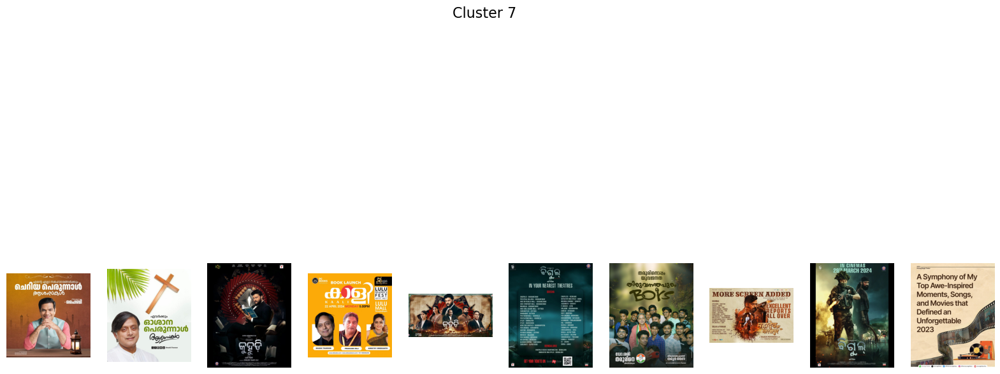

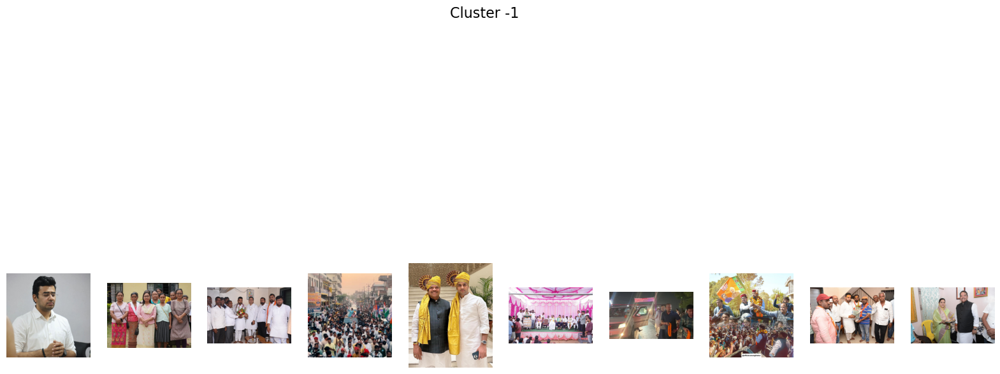

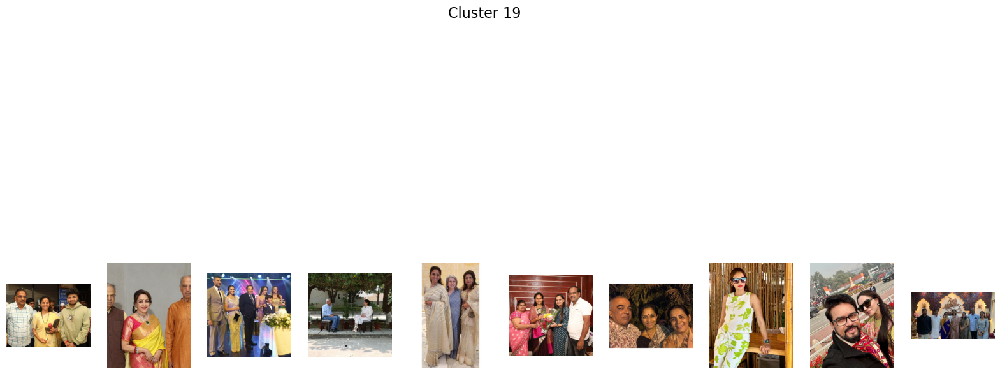

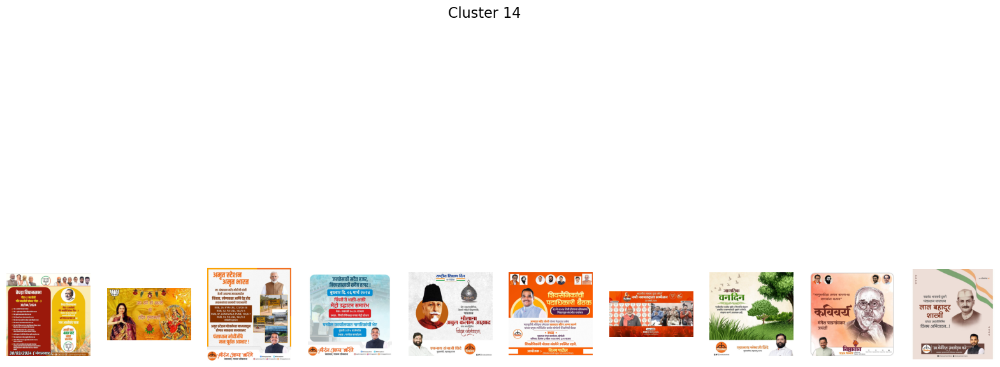

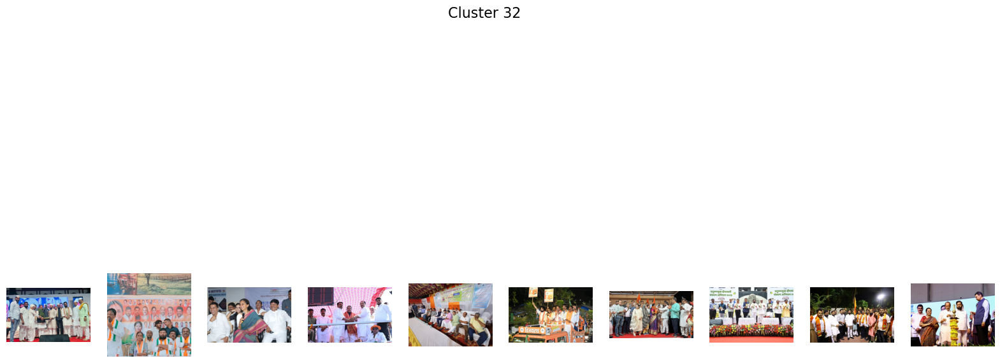

...

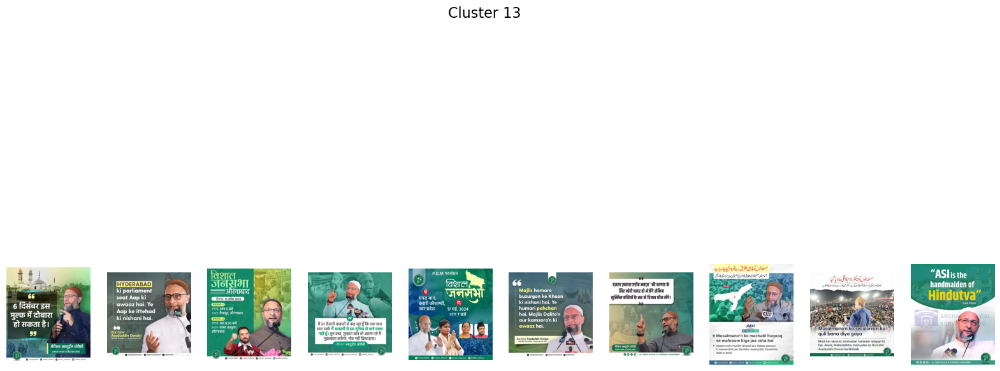

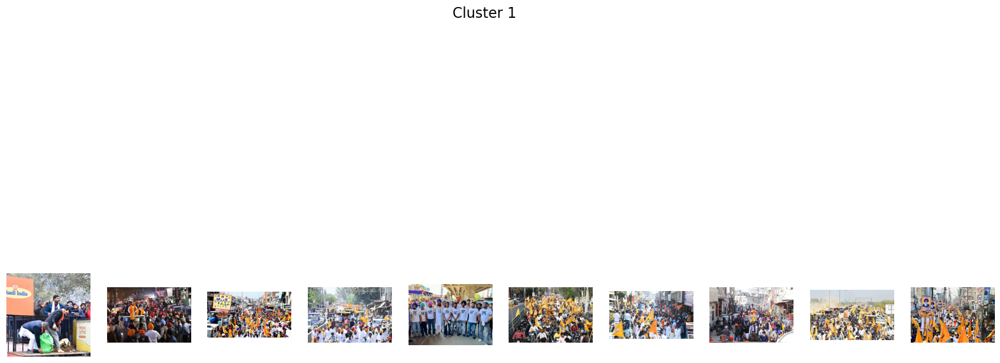

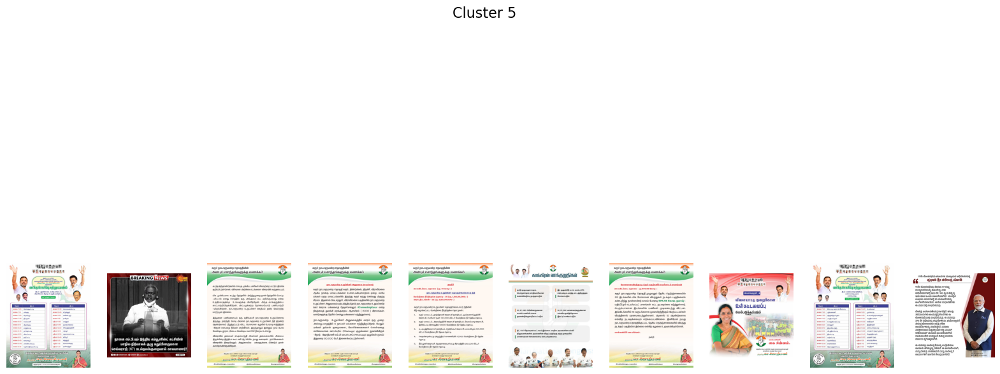

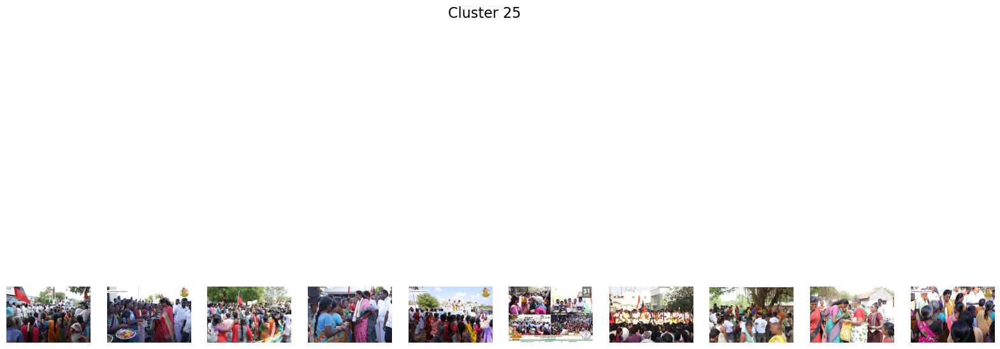

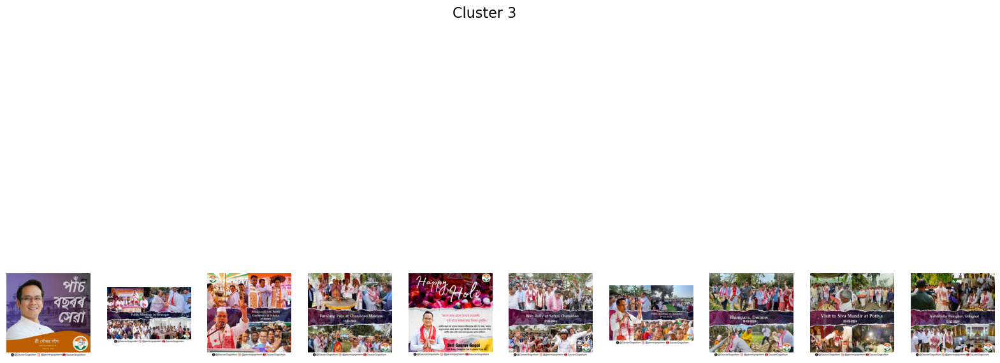

In [16]:
clusters = {}
for cluster_label, image_path in zip(cluster_labels, image_paths):
    if cluster_label not in clusters:
        clusters[cluster_label] = []
    clusters[cluster_label].append(image_path)

# Print the cluster labels and their corresponding image paths
for cluster_label, images in clusters.items():
    plot_cluster_images(cluster_label, images)

In [19]:
import matplotlib.pyplot as plt
from PIL import Image

def plot_cluster_images(cluster_label, images):
    selected_images = images.get(cluster_label, [])
    num_images = len(selected_images)

    if num_images == 0:
        print(f"No images found for cluster {cluster_label}")
        return

    # Determine number of columns dynamically based on number of images
    num_columns = min(num_images, 5)
    num_rows = (num_images - 1) // num_columns + 1

    # Create figure with subplots
    fig, axes = plt.subplots(num_rows, num_columns, figsize=(4 * num_columns, 4 * num_rows))
    fig.suptitle(f'Cluster {cluster_label}', fontsize=16)

    # Flatten axes if num_rows > 1
    if num_rows > 1:
        axes = axes.flatten()

    # Iterate through selected images and plot them
    for i, (ax, image_path) in enumerate(zip(axes, selected_images)):
        img = Image.open(image_path)
        ax.imshow(img)
        ax.axis('off')

    # Hide any extra subplot if num_images < num_columns * num_rows
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

# Example usage:
cluster_label_to_show = 2  # Replace with the desired cluster label
plot_cluster_images(cluster_label_to_show, clusters)
